In [51]:
######### visualization code
from numpy import *
from math import sqrt
import numpy as np

root = '/data2/lchen63/voxceleb'
standard = np.load('/data2/lchen63/voxceleb/unzip/dev_video/id02343/08TabUdunsU/00001.npy')[30]
lmark_path = '/data2/lchen63/voxceleb/unzip/dev_video/id06412/9qvk-3BqEVk/00021.npy'
lmark = np.load(lmark_path)

In [52]:
source=lmark[54]
target=standard

index = [1,2,3,4,5,11,12,13,14,15,27,28,29,30,31,32,33,34,35,39,42,36,45,17,21,22,26]

n = len(index)

oss = mat(source)
ott = mat(target)
source_3 = mat(source[index])
target_3 = mat(target[index])


In [53]:
def rigid_transform_3D(A, B):
    assert len(A) == len(B)

    N = A.shape[0]; # total points

    centroid_A = mean(A, axis=0)
    centroid_B = mean(B, axis=0)
    
    # centre the points
    AA = A - tile(centroid_A, (N, 1))
    BB = B - tile(centroid_B, (N, 1))

    # dot is matrix multiplication for array
    H = transpose(AA) * BB

    U, S, Vt = linalg.svd(H)

    R = Vt.T * U.T

    # special reflection case
    if linalg.det(R) < 0:
       print("Reflection detected")
       Vt[2,:] *= -1
       R = Vt.T * U.T
    
    print(centroid_A)
    print(centroid_B)
    t = -R*centroid_A.T + centroid_B.T

    print( t)

    return R, t


# recover the transformation
ret_R, ret_t = rigid_transform_3D(source_3, target_3)

A2 = (ret_R*oss.T) + tile(ret_t, (1, 68))
A2 = A2.T

# Find the error
err = A2 - ott

err = multiply(err, err)
err = sum(err)
rmse = sqrt(err/n);

print("Points source")
print (source_3)
print ("")

print ("Points target")
print (target_3)
print ("")

print ("Points warped_target")
print (A2)
print ("")

print ("Rotation")
print (ret_R)
print ("")

print ("Translation")
print (ret_t)
print ("")

print ("RMSE:", rmse)
print ("If RMSE is near zero, the function is correct!")




[[116.74074074  82.88888889  -0.44085567]]
[[112.14814815  83.66666667  -0.86226347]]
[[ -7.71964209]
 [ 11.42699234]
 [-31.06665255]]
Points source
[[ 46.          69.         -35.06949234]
 [ 48.          84.         -35.02546692]
 [ 50.         100.         -33.84531784]
 [ 54.         117.         -28.17510986]
 [ 63.         130.         -17.70801544]
 [149.         135.         -35.41113663]
 [156.         122.         -48.78271103]
 [160.         106.         -55.51768494]
 [165.          93.         -57.41145325]
 [169.          77.         -58.34070206]
 [125.          60.          25.33197594]
 [125.          73.          30.45368767]
 [125.          84.          37.58386993]
 [125.          91.          38.27925873]
 [110.          97.          25.19154549]
 [116.          97.          26.38028526]
 [123.         100.          26.19417   ]
 [127.         100.          23.64224815]
 [132.          97.          20.44046783]
 [105.          60.          21.3449707 ]
 [140.     

(68, 3)
(68, 3)
(3, 1)
(3, 3)
0.00229001045227


ValueError: input operand has more dimensions than allowed by the axis remapping

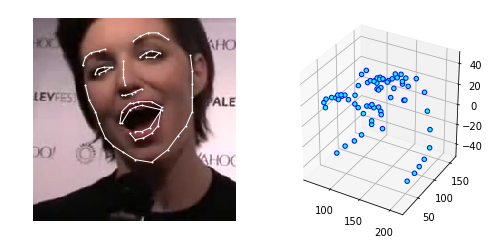

In [82]:
print (A2.shape)
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from skimage import io
import cv2
import os
from scipy.spatial.transform import Rotation as R

root = '/data2/lchen63/voxceleb'
# /data2/lchen63/voxceleb/unzip/dev_video/id05880/55qXtfTk-oI/00018_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id02495/67VqQpS9dmw/00043_RT.npy
# /data2/lchen63/voxceleb/unzip/dev_video/id06453/Kt5_8WlBI8E/00124_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id02821/L6H3RV08O98/00108_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id07358/OovnuNo0vic/00163_RT.npy

v_id = 'id01031/wxAtMlyOKp0/00108'
v_path = '/data2/lchen63/voxceleb/unzip/dev_video/'+ v_id + '.mp4'
RT = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '_sRT.npy')

lmark_path = '/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '.npy'
lmarks = np.load(lmark_path)
count = 137
tt = count

lmark = lmarks[count]
print(lmark.shape)

lmark = mat(lmark)
RT = mat(RT)
import time
t  = time.time()
rec = RT[tt,:3]
r = R.from_rotvec(rec)
ret_R = r.as_dcm()


ret_R2 = ret_R[0].T



ret_t = RT[tt,3:]
ret_t = ret_t.reshape(3,1)

print (ret_t.shape)
print ( ret_R2.shape)
ret_t2 = - ret_R2 * ret_t
ret_t2 = ret_t2.reshape(3,1)


A2 = ret_R*lmark.T
A2+= tile(ret_t, (1, 68))
A2 = A2.T


A3 = ret_R2 *   A2.T
A3+= tile(ret_t2, (1,68))

A3 = A3.T


print (time.time() - t)

tmp = v_path.split('/')
frame_name = os.path.join(root , 'img', tmp[-3], tmp[-2], tmp[-1][:-4] ,'%05d.png'%count)
input = io.imread(frame_name)
preds = A3
#TODO: Make this nice
fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input)
ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
ax.axis('off')

ax = fig.add_subplot(1, 2, 2, projection='3d')
surf = ax.scatter(preds[:,0]*1.2,preds[:,1],preds[:,2],c="cyan", alpha=1.0, edgecolor='b')
ax.plot3D(preds[:17,0]*1.2,preds[:17,1], preds[:17,2], color='blue' )
ax.plot3D(preds[17:22,0]*1.2,preds[17:22,1],preds[17:22,2], color='blue')
ax.plot3D(preds[22:27,0]*1.2,preds[22:27,1],preds[22:27,2], color='blue')
ax.plot3D(preds[27:31,0]*1.2,preds[27:31,1],preds[27:31,2], color='blue')
ax.plot3D(preds[31:36,0]*1.2,preds[31:36,1],preds[31:36,2], color='blue')
ax.plot3D(preds[36:42,0]*1.2,preds[36:42,1],preds[36:42,2], color='blue')
ax.plot3D(preds[42:48,0]*1.2,preds[42:48,1],preds[42:48,2], color='blue')
ax.plot3D(preds[48:,0]*1.2,preds[48:,1],preds[48:,2], color='blue' )

ax.view_init(elev=90., azim=90.)
ax.set_xlim(ax.get_xlim()[::-1])
plt.show()
print ('=======')


(68, 3)


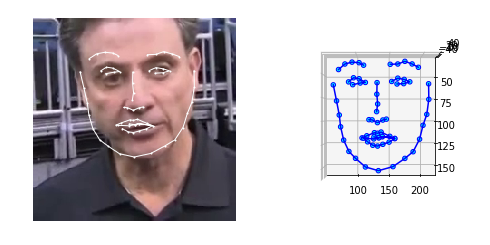

In [74]:
print (A2.shape)
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from skimage import io
import cv2
import os
from scipy.spatial.transform import Rotation as R

root = '/data2/lchen63/voxceleb'
# /data2/lchen63/voxceleb/unzip/dev_video/id05880/55qXtfTk-oI/00018_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id02495/67VqQpS9dmw/00043_RT.npy
# /data2/lchen63/voxceleb/unzip/dev_video/id06453/Kt5_8WlBI8E/00124_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id02821/L6H3RV08O98/00108_RT.npy
#/data2/lchen63/voxceleb/unzip/dev_video/id07358/OovnuNo0vic/00163_RT.npy

v_id = 'id07358/OovnuNo0vic/00161'
v_path = '/data2/lchen63/voxceleb/unzip/dev_video/'+ v_id + '.mp4'
# RT = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '_sRT.npy')

lmark_path = '/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '_front.npy'
lmarks = np.load(lmark_path)
count = 133
tt = count

lmark = lmarks[count]

tmp = v_path.split('/')
frame_name = os.path.join(root , 'img', tmp[-3], tmp[-2], tmp[-1][:-4] ,'%05d.png'%count)
input = io.imread(frame_name)
preds = lmarks[count]
#TODO: Make this nice
fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input)
ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
ax.axis('off')

ax = fig.add_subplot(1, 2, 2, projection='3d')
surf = ax.scatter(preds[:,0]*1.2,preds[:,1],preds[:,2],c="cyan", alpha=1.0, edgecolor='b')
ax.plot3D(preds[:17,0]*1.2,preds[:17,1], preds[:17,2], color='blue' )
ax.plot3D(preds[17:22,0]*1.2,preds[17:22,1],preds[17:22,2], color='blue')
ax.plot3D(preds[22:27,0]*1.2,preds[22:27,1],preds[22:27,2], color='blue')
ax.plot3D(preds[27:31,0]*1.2,preds[27:31,1],preds[27:31,2], color='blue')
ax.plot3D(preds[31:36,0]*1.2,preds[31:36,1],preds[31:36,2], color='blue')
ax.plot3D(preds[36:42,0]*1.2,preds[36:42,1],preds[36:42,2], color='blue')
ax.plot3D(preds[42:48,0]*1.2,preds[42:48,1],preds[42:48,2], color='blue')
ax.plot3D(preds[48:,0]*1.2,preds[48:,1],preds[48:,2], color='blue' )

ax.view_init(elev=90., azim=90.)
ax.set_xlim(ax.get_xlim()[::-1])
plt.show()
print ('=======')


In [82]:
import pickle
import torch
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from skimage import io
import cv2
import os
from scipy.spatial.transform import Rotation as R
from random import shuffle

def compute_RT():
    k = 20
    _file = open( "/data2/lchen63/voxceleb/txt/train_clean.pkl", "rb")
    train_data = pickle.load(_file)
    shuffle(train_data)
    landmarks = []
    lmark_list = []
    
    for index in range(len(train_data)):
        if index ==200:
            break
        for i in range(len(train_data[index][2])):
            lmark_path = os.path.join('/data2/lchen63/voxceleb/unzip', train_data[index][0], train_data[index][2][i] + '_front.npy' )
            t_lmark = np.load(lmark_path)
            if t_lmark.shape[0] < 64:
                continue
        lmark_list.append(torch.FloatTensor(t_lmark) )
    print (lmark_list[0].shape)
    print (lmark_list[1].shape)
    lmark_list = torch.cat(lmark_list,0)
    print (lmark_list.shape)
    lmark_list = lmark_list[:,:48]
    lmark_list = lmark_list.view(lmark_list.size(0)  ,  48* 3)
    mean = torch.mean(lmark_list,0)
    std = torch.std(lmark_list,0)
    lmark_list = (lmark_list - mean.expand_as(lmark_list))/std
    print (lmark_list.shape)
    values, _ = torch.max(lmark_list, 0)
    print (values)
    
    values, _ = torch.min(lmark_list, 0)
    print (values)
#     np.save('./basics/mean_front.npy', mean.numpy())
#     np.save('./basics/std_front.npy', std.numpy())
#     lmark_list = lmark_list - mean.expand_as(lmark_list)

    U,S,V  = torch.svd(torch.t(lmark_list))
    
#     print (U[:,:10])
    C = torch.mm(lmark_list, U[:,:k])
#     np.save('./basics/U_front.npy', U.numpy())

compute_RT()

torch.Size([285, 68, 3])
torch.Size([177, 68, 3])
torch.Size([40133, 68, 3])
torch.Size([40133, 144])
tensor([4.0469, 3.9783, 3.7678, 3.7767, 3.5834, 3.8205, 3.7483, 4.2173, 3.8155,
        3.5177, 5.8492, 3.7544, 3.5533, 6.0035, 3.5381, 3.6348, 5.1542, 3.4195,
        4.4219, 5.4510, 4.5015, 4.4033, 5.2503, 4.8751, 3.9808, 5.0102, 4.8826,
        4.6861, 4.7868, 4.7676, 5.1644, 4.9789, 4.3483, 5.1102, 5.4327, 3.5188,
        5.0091, 5.2840, 3.2880, 5.3492, 5.2864, 3.5811, 5.5631, 4.1205, 3.7271,
        5.4160, 4.6035, 3.9025, 5.4466, 3.6926, 3.7382, 3.4718, 3.2244, 3.6655,
        3.4504, 2.9415, 4.5332, 3.4615, 2.6374, 4.9919, 3.4328, 2.5851, 5.3589,
        3.3001, 2.5876, 5.6918, 5.5908, 3.0067, 5.5580, 5.9000, 2.9572, 5.1408,
        5.9531, 3.1705, 4.6409, 6.0310, 3.1334, 4.4061, 6.0798, 3.4610, 4.3604,
        3.7462, 3.3668, 5.2859, 3.9495, 3.6048, 4.8810, 3.5249, 4.3870, 4.8647,
        3.4932, 4.6144, 4.7155, 4.3531, 4.9286, 4.6489, 3.5238, 5.0479, 4.7747,
        3.9967, 4.

(68, 3)


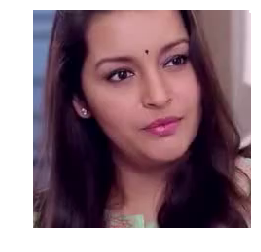

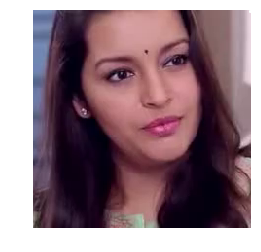

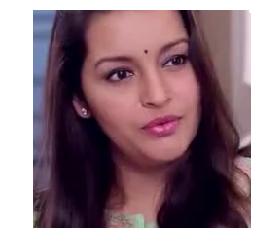

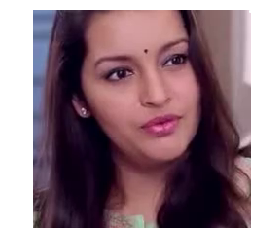

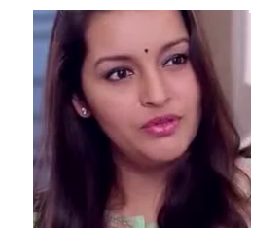

...

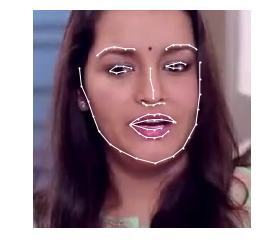

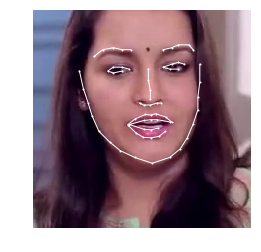

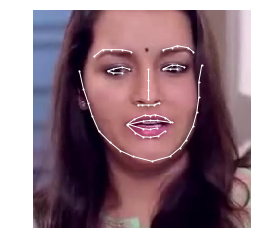

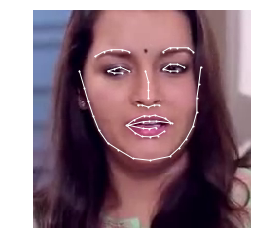

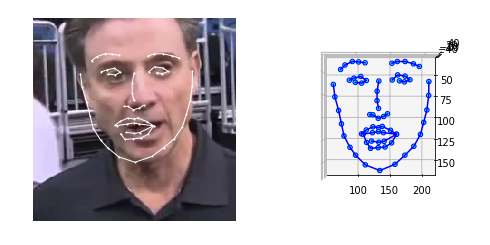

In [47]:

v_id = 'id07358/OovnuNo0vic/00161'
v_path = '/data2/lchen63/voxceleb/unzip/dev_video/'+ v_id + '.mp4'
# RT = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '_sRT.npy')
root = '/data2/lchen63/voxceleb/'
lmark_path = '/data2/lchen63/voxceleb/unzip/dev_video/' + v_id  + '_front.npy'
lmarks = np.load(lmark_path)
count = 116
tt = count
lmark = lmarks[count]
tmp = v_path.split('/')
frame_name = os.path.join(root , 'img', tmp[-3], tmp[-2], tmp[-1][:-4] ,'%05d.png'%count)
input = io.imread(frame_name)
preds = lmarks[count]
print (preds.shape)
#TODO: Make this nice
fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input)
ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
ax.axis('off')

ax = fig.add_subplot(1, 2, 2, projection='3d')
surf = ax.scatter(preds[:,0]*1.2,preds[:,1],preds[:,2],c="cyan", alpha=1.0, edgecolor='b')
ax.plot3D(preds[:17,0]*1.2,preds[:17,1], preds[:17,2], color='blue' )
ax.plot3D(preds[17:22,0]*1.2,preds[17:22,1],preds[17:22,2], color='blue')
ax.plot3D(preds[22:27,0]*1.2,preds[22:27,1],preds[22:27,2], color='blue')
ax.plot3D(preds[27:31,0]*1.2,preds[27:31,1],preds[27:31,2], color='blue')
ax.plot3D(preds[31:36,0]*1.2,preds[31:36,1],preds[31:36,2], color='blue')
ax.plot3D(preds[36:42,0]*1.2,preds[36:42,1],preds[36:42,2], color='blue')
ax.plot3D(preds[42:48,0]*1.2,preds[42:48,1],preds[42:48,2], color='blue')
ax.plot3D(preds[48:,0]*1.2,preds[48:,1],preds[48:,2], color='blue' )

ax.view_init(elev=90., azim=90.)
ax.set_xlim(ax.get_xlim()[::-1])
plt.show()
print ('=======')

In [9]:
pca = torch.FloatTensor( np.load('./basics/U_front.npy')[:,:6]).cuda()
mean =torch.FloatTensor( np.load('./basics/mean_front.npy')).cuda()
std=torch.FloatTensor( np.load('./basics/std_front.npy')).cuda()

print (preds.shape)
new = torch.zeros((1,60)).float().cuda()
preds_part = preds[48:].reshape(-1)

print  (type(preds))
preds_part = torch.FloatTensor( preds_part)
new[0] = preds_part
preds_part = new
preds_part  = preds_part - mean.expand_as(preds_part)
preds_part = torch.mm(preds_part,  pca)
print (preds_part)

(68, 3)
<type 'numpy.ndarray'>
tensor([[ 4.6843, -0.8533,  4.3587,  1.0259,  4.1231,  3.3161]],
       device='cuda:0')


In [10]:
fake_lmark_part = torch.mm( preds_part, pca.t() )
fake_lmark_part = fake_lmark_part + mean.expand_as(fake_lmark_part)

(1, 60)


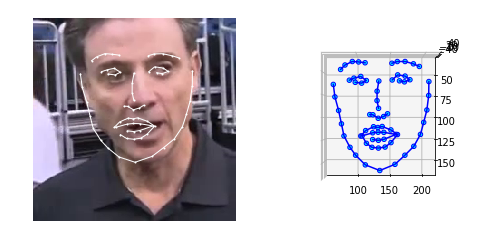

In [11]:
preds_part =fake_lmark_part.cpu().numpy()
print (preds_part.shape)

preds_part = preds_part.reshape(20,3)

preds[48:] = preds_part

#TODO: Make this nice
fig = plt.figure(figsize=plt.figaspect(.5))
ax = fig.add_subplot(1, 2, 1)
ax.imshow(input)
ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
ax.axis('off')

ax = fig.add_subplot(1, 2, 2, projection='3d')
surf = ax.scatter(preds[:,0]*1.2,preds[:,1],preds[:,2],c="cyan", alpha=1.0, edgecolor='b')
ax.plot3D(preds[:17,0]*1.2,preds[:17,1], preds[:17,2], color='blue' )
ax.plot3D(preds[17:22,0]*1.2,preds[17:22,1],preds[17:22,2], color='blue')
ax.plot3D(preds[22:27,0]*1.2,preds[22:27,1],preds[22:27,2], color='blue')
ax.plot3D(preds[27:31,0]*1.2,preds[27:31,1],preds[27:31,2], color='blue')
ax.plot3D(preds[31:36,0]*1.2,preds[31:36,1],preds[31:36,2], color='blue')
ax.plot3D(preds[36:42,0]*1.2,preds[36:42,1],preds[36:42,2], color='blue')
ax.plot3D(preds[42:48,0]*1.2,preds[42:48,1],preds[42:48,2], color='blue')
ax.plot3D(preds[48:,0]*1.2,preds[48:,1],preds[48:,2], color='blue' )

ax.view_init(elev=90., azim=90.)
ax.set_xlim(ax.get_xlim()[::-1])
plt.show()
print ('=======')

In [72]:
import numpy as np
import torch
pca = torch.FloatTensor( np.load('./basics/U_front.npy')[:,:6]).cuda()
mean =torch.FloatTensor( np.load('./basics/mean_front.npy')).cuda()
std =torch.FloatTensor( np.load('./basics/std_front.npy')).cuda()

vid = 'id07294/PtHmwQygx8Q/00010'
lmarks = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '_front.npy')
print(lmarks.shape)

(139, 68, 3)


In [73]:

lmarks_part = torch.FloatTensor(lmarks[:,48:, ]).cuda()
lmarks_part = lmarks_part.view(lmarks_part.shape[0], -1)
lmark_pca = (lmarks_part - mean.expand_as(lmarks_part))/std
lmark_pca = torch.mm(lmark_pca,  pca)
print (lmark_pca.shape)

torch.Size([139, 6])


(101,)
(101,)
(101,)
(101,)
(101,)
(101,)


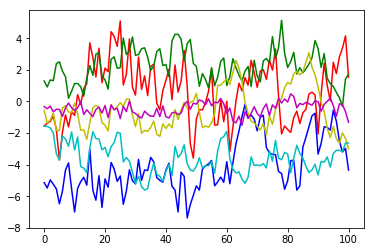

In [70]:
import numpy as np
import matplotlib.pyplot as plt
plot_v = lmark_pca.cpu().numpy()
t = np.arange(0, lmark_pca.shape[0], 1)
g = []
for gg in range(6):
    g.append(plot_v[:,gg])
    print (g[gg].shape)
plt.plot(t, g[0], 'r-', t, g[1], 'b-', t, g[2], 'g-',t, g[3], 'y-', t, g[4], 'c-', t, g[5], 'm-')
plt.show()

In [74]:
def vis(img,lmark1,lmark2):
#     img  = io.imread(img_path)
    preds = lmark1
    fig = plt.figure(figsize=plt.figaspect(.5))
    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(img)
    ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
    ax.axis('off')
    
    preds = lmark2
    
    ax = fig.add_subplot(1, 2, 2)
    ax.imshow(img)
    ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
    ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
    ax.axis('off')
    plt.show()

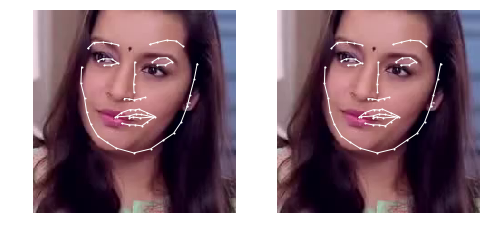

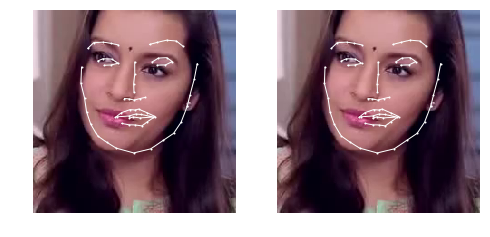

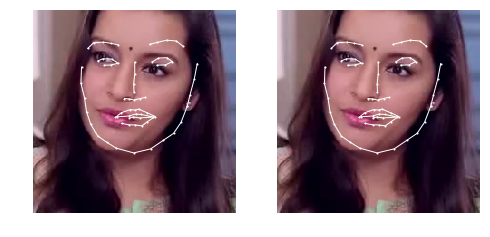

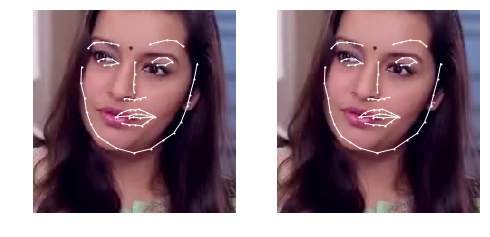

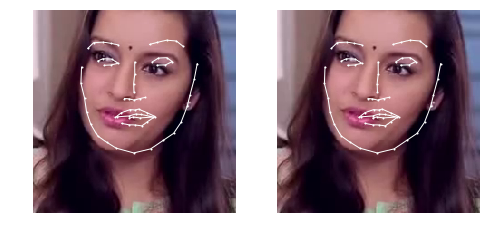

...

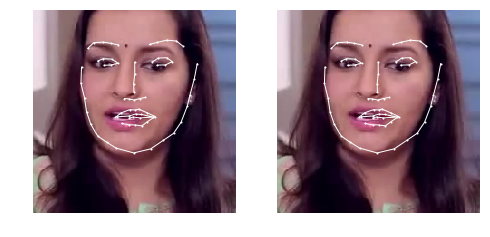

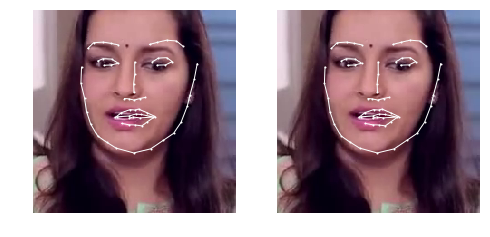

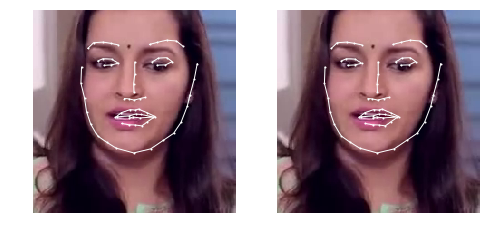

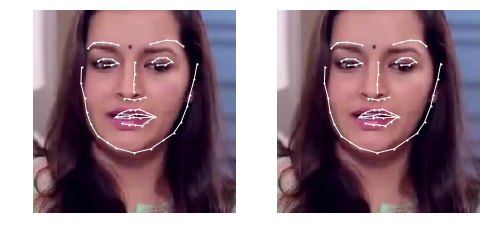

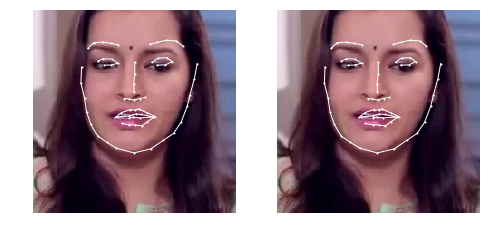

In [65]:
video_path =  '/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '.mp4'
cap = cv2.VideoCapture(video_path)
for t in range(lmarks.shape[0]):
    ret, frame = cap.read()
    if ret:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      
        vis(frame,lmark_t,lmark_t)


torch.Size([139, 6])


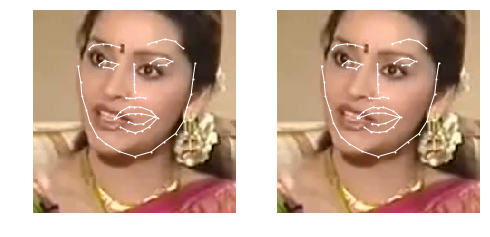

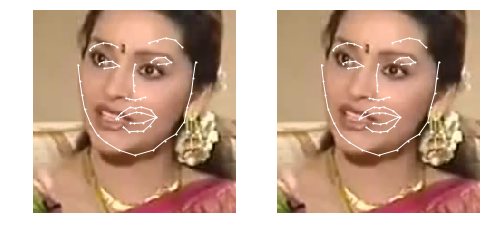

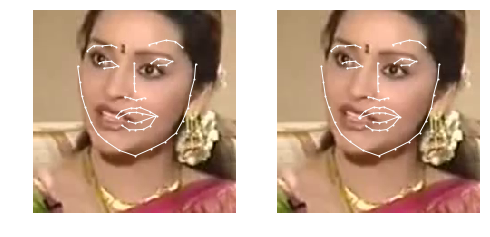

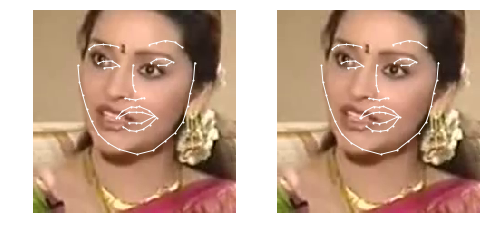

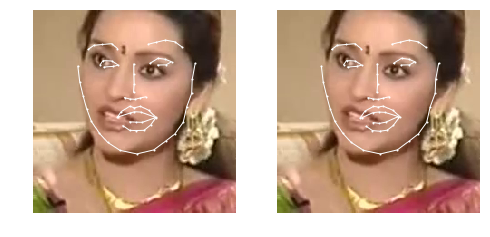

...

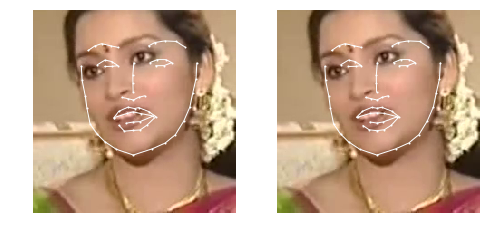

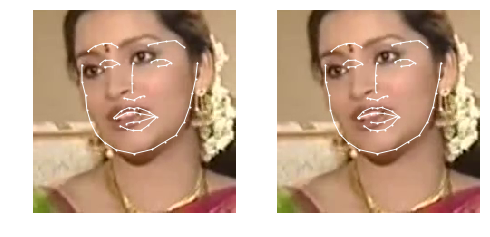

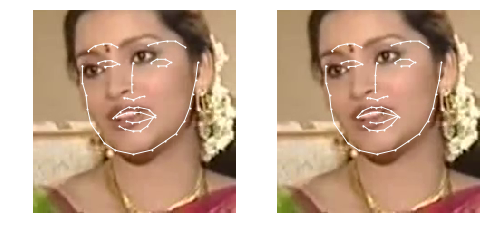

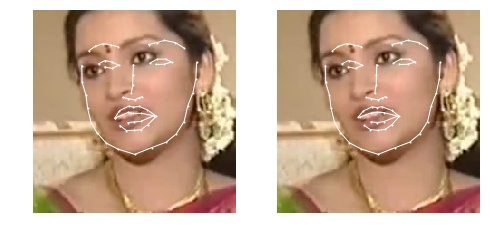

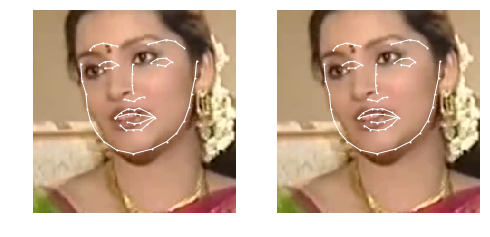

In [75]:

print(lmark_pca.shape)
lmark_pca1 = torch.mm( lmark_pca, pca.t() )
lmark_pca1 = lmark_pca1 * std + mean.expand_as(lmark_pca1)

lmark_pca1 = lmark_pca1.view(lmark_pca1.shape[0],  20,3)
lmarksr = lmarks.copy()
lmarksr[:,48:] = lmark_pca1.cpu().numpy()
# for t in range(lmarks.shape[0]):
#     lmark_t = lmarks[t]
#     lmark_r = lmarksr[t]
#     img_path = '/data2/lchen63/voxceleb/img/' + vid +   '/%05d.png'%t
#     vis(img_path,lmark_t,lmark_r)
video_path =  '/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '.mp4'
cap = cv2.VideoCapture(video_path)
for t in range(lmarks.shape[0]):
    ret, frame = cap.read()
    if ret:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        lmark_t = lmarks[t]
        lmark_r = lmarksr[t]
        vis(frame,lmark_t,lmark_r)


In [34]:
RT = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '_sRT.npy')
olmark = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '.npy')
from scipy.spatial.transform import Rotation as R

print (RT.shape)
from numpy import *
for t in range(lmarks.shape[0]):
    lmark_t = lmarks[t]
    lmark_r = lmarksr[t]
    lmark = mat(lmark_r)
    RT = mat(RT)

    rec = RT[t,:3]
    
    r = R.from_rotvec(rec)
    ret_R = r.as_dcm()


    ret_R2 = ret_R[0].T



    ret_t = RT[t,3:]
    ret_t = ret_t.reshape(3,1)


    ret_t2 = - ret_R2 * ret_t
    ret_t2 = ret_t2.reshape(3,1)
#     A2 = ret_R*lmark.T
#     A2+= tile(ret_t, (1, 68))
#     A2 = A2.T
    A3 = ret_R2 *   lmark.T
    A3+= tile(ret_t2, (1,68))
    A3 = A3.T    
    img_path = '/data2/lchen63/voxceleb/img/' + vid +   '/%05d.png'%t
#     vis(img_path,olmark[t],A3)
    



(101, 6)


In [35]:
RT = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '_sRT.npy')
olmark = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + vid +  '.npy')

print (RT.shape)
from numpy import *
rlmark = np.zeros(olmark.shape)
for t in range(lmarks.shape[0]):
    lmark_t = lmarks[t]
    lmark_r = lmarksr[t]
    lmark = mat(lmark_r)
    RT = mat(RT)

    rec = RT[t,:3]
    
    r = R.from_rotvec(rec)
    ret_R = r.as_dcm()


    ret_R2 = ret_R[0].T



    ret_t = RT[t,3:]
    ret_t = ret_t.reshape(3,1)


    ret_t2 = - ret_R2 * ret_t
    ret_t2 = ret_t2.reshape(3,1)
#     A2 = ret_R*lmark.T
#     A2+= tile(ret_t, (1, 68))
#     A2 = A2.T
    A3 = ret_R2 *   lmark.T
    A3+= tile(ret_t2, (1,68))
    A3 = A3.T    
    rlmark[t] = A3
#     img_path = '/data2/lchen63/voxceleb/img/' + vid +   '/%05d.png'%t
#     vis(img_path,olmark[t],A3)

(101, 6)


In [36]:
import matplotlib.pyplot as plt
from skimage import io
print (rlmark.shape)
def lmark2img( lmark1,video_id= None, real= True):        
    for i in range(lmark1.shape[0]):
#         print (i)
        preds = lmark1[i]
        plt.ioff()
        fig = plt.figure(figsize=plt.figaspect(.5))
    
        ax = fig.add_subplot(1, 1, 1)
        if video_id != None:
            img_path = '/data2/lchen63/voxceleb/img/' + video_id +   '/%05d.png'%i
            img  = io.imread(img_path)
        ax.imshow(img)
        ax.plot(preds[0:17,0],preds[0:17,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[17:22,0],preds[17:22,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[22:27,0],preds[22:27,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[27:31,0],preds[27:31,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[31:36,0],preds[31:36,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[36:42,0],preds[36:42,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[42:48,0],preds[42:48,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[48:60,0],preds[48:60,1],marker='o',markersize=1,linestyle='-',color='w',lw=1)
        ax.plot(preds[60:68,0],preds[60:68,1],marker='o',markersize=1,linestyle='-',color='w',lw=1) 
        ax.axis('off')
#         ax.view_init(elev=90., azim=90.)
        ax.set_xlim(ax.get_xlim()[::-1])
    #     ax.show()
        if real:
            plt.savefig("./tmp/%04d.png"%i)
        else:
            plt.savefig("./tmp/f%04d.png"%i)


def lmark2video(video_id):
    olmark = np.load('/data2/lchen63/voxceleb/unzip/dev_video/' + video_id +  '.npy')
    audio_path = '/data2/lchen63/voxceleb/unzip/dev_audio/' + video_id +  '.m4a'
    lmark2img(rlmark, video_id,False)
    
lmark2video(vid)


(101, 68, 3)
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


In [38]:
print (lmark_pca.shape)

torch.Size([101, 6])


In [39]:
print (lmark_pca)

tensor([[  8.8242, -15.1929, -10.3930,   2.7161,   4.7984,  -1.2977],
        [  9.4424, -15.2300, -11.3365,   4.3314,   5.2858,  -1.7222],
        [  9.5218, -14.5457,  -9.8234,   3.4039,   5.1615,  -0.6093],
        [ 10.3161, -13.7163,  -9.9139,   3.5883,   5.9785,  -0.4996],
        [ 11.4658, -18.2110,  -7.7356,   6.0097,   9.0927,  -0.3628],
        [  9.7063, -25.8686,  -7.9126,   5.8900,  11.0697,  -0.5730],
        [ 10.1816, -18.1725, -10.3803,   2.1074,   6.5195,  -2.2415],
        [  9.6371, -11.6531,  -7.5924,   1.3733,   6.9009,  -0.8532],
        [  4.1159, -11.3047,  -5.6618,   3.5843,   9.3011,  -0.5021],
        [ 10.0038, -12.6228, -11.9280,   2.9031,   6.8135,  -1.9517],
        [ 12.5624, -16.4176, -14.4217,   2.2718,  10.2303,  -2.0301],
        [ 12.9862, -10.3278, -12.0055,   3.6290,   6.7322,  -1.1457],
        [ 10.4776, -11.0243,  -7.8346,   6.3230,  12.5715,  -1.2166],
        [ 10.7668,  -6.8044,  -7.5677,   6.8495,  12.8380,  -1.3962],
        [ 14.0563,  

In [84]:
mfcc = '/data2/lchen63/voxceleb/unzip/dev_audio/id07525/kEoUOOXkMPY/00136.npy'
b = np.load(mfcc)
print (b.shape)
for i in range(b.shape[0]):
    print (b[i])

(953, 13)
[-1.09884961e+00 -3.47771776e+01  2.50459233e+01 -8.28207742e-03
 -9.01458764e+00  2.03853549e+01 -3.22204337e+01  1.13788014e+01
 -7.07418282e+00  3.35787713e+00  2.32087580e+01 -1.13739597e+01
  8.56816341e+00]
[ -1.2379887  -34.01165467  19.69611387  -0.27041931 -12.06161119
  22.47909854 -23.77864405  14.02399405  -2.54909401  -6.4700171
  16.26653563 -11.06521479   1.06075303]
[ -1.74617044 -28.31753324  15.80653276  -1.13047734 -18.39084273
  16.72978812 -29.46516721  19.23173844   7.20266207  -0.19481448
  18.63037052  -2.29890957  -2.00635091]
[ -3.13311104 -21.37034105   5.8572105    4.72239821 -15.58168608
  12.8098134  -24.08839564  18.51345494  10.38662573  -0.72330183
  22.913445    -4.14938188   3.57943298]
[-5.30629207 -7.90072477  6.44578057 12.5837977   1.4596591   9.56099039
 -2.87755027 11.35962549 -2.83593688 -8.11854821  7.13996171 -5.54913289
 -7.74189072]
[ -5.33608529   2.72552647   9.95752844  15.66347861  -1.13272229
  -9.91970694 -10.30523168  -5.47

[ -4.48838174  14.81955182   1.73189984  17.33075023  12.95891294
 -32.47219446 -21.35258496  -8.04834902   2.68121987 -32.04302034
   4.32057002  23.07726275 -39.50278327]
[ -4.57473211  15.61994496   1.38273275  18.74911199  12.44527187
 -27.27892988 -15.53743419  -5.77796741   8.24176529 -28.77969679
   8.96737561  24.75890881 -33.67755883]
[ -4.4260111   10.12288435  -3.74219511  17.94748299  14.79035202
 -33.53283085 -23.25124564 -15.58933114  -1.08533761 -24.35424745
   2.07673177  16.47937851 -35.33663846]
[ -4.32584793  12.4124186   -3.65618316  15.68211394  18.56991999
 -30.91852651 -21.57266317 -12.23500451   9.29148968 -32.38828217
   5.83568509  25.33805389 -42.88350664]
[ -4.33996823  11.72396299  -6.95632812  13.36644794  12.33565378
 -32.46923716 -25.16796113 -14.19875731   4.34722209 -38.17082437
  -0.83210742  16.28527205 -47.3204095 ]
[ -4.39777754  12.42821536  -5.78615276  14.2298441   12.29019467
 -27.27189404 -21.59462556 -11.50182537   6.63060313 -36.54559176
   

In [3]:
import numpy as np

a = '/home/lchen63/head/basics/S.npy'
a = '/home/lchen63/ATVGnet/basics/mean_shape_img.npy' 
    
b = np.load(a)
print (b.shape)




(68, 2)


In [2]:
b[0]

array([ 0.01837205,  0.26238165,  0.02886476,  0.23402641,  0.02533789,
        0.20505266,  0.01209468,  0.18431329, -0.01391702,  0.16881661,
       -0.03549474,  0.14768979, -0.04054674,  0.12248021, -0.03087693,
        0.08651656, -0.00194148,  0.07738997,  0.02670814,  0.08887257,
        0.0437773 ,  0.12610636,  0.03999137,  0.15355985,  0.02317035,
        0.17389821,  0.00366525,  0.18942499, -0.01305601,  0.20795041,
       -0.02790977,  0.23026544, -0.02162565,  0.25894947, -0.00183188,
        0.1058326 , -0.0340272 ,  0.04851261, -0.02855547,  0.0004944 ,
       -0.00461937, -0.02530244,  0.01854976, -0.03808355, -0.01941945,
       -0.04490768,  0.00320141, -0.03458744,  0.02558877, -0.01481528,
        0.02692264,  0.03461758, -0.00908101,  0.09397449,  0.00119953,
       -0.06262951,  0.00051706, -0.12447839, -0.00089873, -0.18703506,
       -0.00314943, -0.24219006, -0.00132175, -0.13876208,  0.00191686,
       -0.14833672,  0.00280475, -0.15471466,  0.00202405, -0.14

In [5]:


gt_front = np.load('/data/lchen63/grid/zip/video/s1/video/mpg_6000/bbaf2n_front.npy')
import cv2
from util import utils

for gg in range(gt_front.shape[0]):
    print (gg)
    backgroung = cv2.imread('./image/background.png')
    backgroung= cv2.cvtColor(backgroung, cv2.COLOR_BGR2RGB) 
    lmark_name  = "./temp/%05d.png"%gg
    plt = utils.lmark2img(gt_front[gg].reshape((68,3)), backgroung, c = 'b')
    plt.savefig(lmark_name)
            

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22


/data/lchen63/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74


In [7]:
import os
video_name = os.path.join('./temp' , 'real.mp4')
utils.image_to_video(os.path.join('./', 'temp'), video_name )

ffmpeg -framerate 25  -i ./temp/%05d.png -c:v libx264 -y -vf format=yuv420p ./temp/real.mp4


In [8]:
mean =np.load('./basics/mean_grid.npy') 
plt = utils.lmark2img(mean.reshape((68,3)), backgroung, c = 'b')
plt.savefig(lmark_name)

In [75]:


import numpy as np

import matplotlib.pyplot as plt

from scipy.signal import savgol_filter

from scipy.signal import savgol_filter
window_size1 =21
window_size2 =7
degree1 = 2
degree2 = 1
open_pair = []
for i in range(3):
    open_pair.append([i + 61, 67 - i])





data = np.load('/data/lchen63/grid/zip/video/s1/video/mpg_6000/bbaf2n_front.npy')
for i in range(data.shape[1]):
    for j in range(data.shape[2]):
        if i < 48:
            data[:,i,j] = savgol_filter(data[:,i,j], window_size1, degree2)
        else:
            data[:,i,j] = savgol_filter(data[:,i,j], window_size2, degree1)

real_open = np.zeros((3,75))
for k in range(3):
    real_open[k] = (data[:,open_pair[k][0], 1] - data[:,open_pair[k][1] , 1])
real_open = np.abs(real_open)
real_open = np.sum(real_open, axis = 0)
for  i in range(data.shape[0]):
    if real_open[i] < 8 :
        for k in range(3):
            data[i, open_pair[k][0], 1 ] =  data[i, open_pair[k][1], 1 ] = ( data[i, open_pair[k][0], 1]  + data[i, open_pair[k][1], 1 ]) / 2.0
        
# for i in range(data.shape[1]):
#     for j in range(data.shape[2]):
#         if i < 48:
#             data[:,i,j] = savgol_filter(data[:,i,j], window_size1, 1)
#         else:
#             data[:,i,j] = savgol_filter(data[:,i,j], window_size2, 3)
        
np.save('./temp/bbaf2n_front_5_3.npy', data)









In [76]:
gt_front = np.load('./temp/bbaf2n_front_5_3.npy')
import cv2
from util import utils

for gg in range(gt_front.shape[0]):
    backgroung = cv2.imread('./image/background.png')
    backgroung= cv2.cvtColor(backgroung, cv2.COLOR_BGR2RGB) 
    lmark_name  = "./temp2/%05d.png"%gg
    plt = utils.lmark2img(gt_front[gg].reshape((68,3)), backgroung, c = 'b')
    plt.savefig(lmark_name)

In [77]:
video_name = os.path.join('./temp2' , 'real.mp4')
utils.image_to_video(os.path.join('./', 'temp2'), video_name )

ffmpeg -framerate 25  -i ./temp2/%05d.png -c:v libx264 -y -vf format=yuv420p ./temp2/real.mp4


In [78]:
utils.add_audio(video_name, '/data/lchen63/grid/zip/audio/s1/bbaf2n.wav')
print ('The generated video is: {}'.format('./temp2'  , 'real.mov'))

ffmpeg -i ./temp2/real.mp4 -i /data/lchen63/grid/zip/audio/s1/bbaf2n.wav -vcodec copy  -acodec copy -y  ./temp2/real.mov
The generated video is: ./temp2


In [79]:
print (gt_front.shape)
open_pair = []
for i in range(3):
    open_pair.append([i + 61, 67 - i])
real_open = []
for k in range(3):
    real_open.append(gt_front[:,open_pair[k][0], :] - gt_front[:,open_pair[k][1] , :])
    
print (real_open)
real_open = np.array(real_open)
print (real_open.shape)
real_open = np.abs(real_open)
real_open = np.sum(real_open, axis = 0)

(75, 68, 3)
[array([[-0.64697523,  0.        ,  3.48356517],
       [-1.15472852,  0.        ,  3.04377031],
       [-0.99637395, -2.85778355,  2.79448048],
       [-0.50773818, -3.12598555,  2.68955428],
       [ 0.15910887, -3.02246948,  2.73693019],
       [-0.31447941, -2.98482928,  2.74042342],
       [-1.07427903,  0.        ,  2.6191674 ],
       [-1.47607769,  0.        ,  2.71723066],
       [-1.51225621,  0.        ,  3.11332925],
       [-1.1537108 , -3.10650404,  3.4043798 ],
       [-0.43713064, -3.92930371,  3.88194049],
       [-0.20842951, -4.27278644,  4.43355718],
       [-0.38458459, -5.191443  ,  4.31289059],
       [-0.37535817, -4.86918451,  4.23226729],
       [-0.37871701, -5.40541969,  4.33254811],
       [-0.38065886, -6.3139808 ,  4.46845551],
       [-0.41327192, -6.91169072,  4.73985358],
       [-0.46801098, -6.98273327,  5.02068209],
       [-0.47338566, -7.72685626,  5.04020837],
       [-0.45283092, -7.17558295,  4.80081401],
       [-0.40674803, -6.240

In [80]:
for i in range(75):
    print (i, real_open[i])

(0, array([ 1.17598143,  0.        , 11.57530832]))
(1, array([ 1.8540855 ,  0.        , 10.33213844]))
(2, array([1.73954957, 8.63118187, 9.55589402]))
(3, array([1.3423726 , 9.4546904 , 9.14753761]))
(4, array([1.79200261, 9.18048742, 9.08499302]))
(5, array([2.27583061, 9.05618267, 9.14361701]))
(6, array([2.89530012, 0.        , 8.92712349]))
(7, array([2.73060186, 0.        , 9.39938394]))
(8, array([ 2.41329983,  0.        , 10.65720769]))
(9, array([ 1.67898969,  8.81141391, 11.5410768 ]))
(10, array([ 1.88627493, 12.354277  , 12.69749421]))
(11, array([ 2.59257886, 15.39219209, 14.14157387]))
(12, array([ 2.84719197, 17.94616745, 13.81471507]))
(13, array([ 2.79816958, 18.02156753, 13.52000067]))
(14, array([ 2.71393058, 18.9534668 , 13.79707985]))
(15, array([ 2.35808001, 20.81000361, 14.33160303]))
(16, array([ 2.65038149, 23.07085304, 15.16884902]))
(17, array([ 2.91124804, 24.03787922, 16.02755832]))
(18, array([ 2.28991925, 25.30570011, 16.20722078]))
(19, array([ 1.839736